In [ ]:
# Import libraries
from google.colab import drive
import pandas as pd
import numpy as np
import os

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score

import seaborn as sns
import matplotlib.pyplot as plt

# Load data from Google Drive

In [ ]:
# Mount Google Drive
drive.mount('/content/drive', force_remount=True)

# Read multiple CSV files
demo_data = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/DEMO_DATA.csv', sep ='\t')
albumin = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/ALBUMIN.csv', sep ='\t')
bicarbonate = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/BICARBONATE.csv', sep ='\t')
blood_glucose = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/BLOOD_GLUCOSE.csv', sep = '\t')
blood_urea_nitrogen = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/BLOOD_UREA_NITROGEN.csv', sep ='\t')
creatinine = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/CREATININE.csv', sep ='\t')
hematrocrit = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/HEMATROCRIT.csv', sep ='\t')
platelet_count = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/PLATELET_COUNT.csv', sep ='\t')
potasssium = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/POTASSSIUM.csv', sep ='\t')
sodium = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/SODIUM.csv', sep ='\t')
white_blood_cells = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/WHITE_BLOOD_CELLS.csv', sep ='\t')
art_ph = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/ART_PH.csv', sep ='\t')
cvp = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/CVP.csv', sep ='\t')
dias_press = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/DIAS_PRESS.csv', sep ='\t')
hr = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/HR.csv', sep ='\t')
resp_rate = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/RESP_RATE.csv', sep ='\t')
spo2 = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/SPO2.csv', sep ='\t')
sys_press = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/SYS_PRESS.csv', sep ='\t')
temp = pd.read_csv('/content/drive/My Drive/IE6400/Project/Datasets/TEMP.csv', sep ='\t')

Mounted at /content/drive


In [ ]:
# Putting all dataframes in a list
dfs = [demo_data, albumin, bicarbonate, blood_glucose, blood_urea_nitrogen, creatinine, hematrocrit, platelet_count, potasssium,
      sodium, white_blood_cells, art_ph, cvp, dias_press, hr, resp_rate, spo2, sys_press, temp]

# Dropping the 'Unnamed: 0' column
for df in dfs:
    df.drop(columns= ["Unnamed: 0"], inplace = True)

In [ ]:
# Joining dataframes using 'OUTER JOIN' on 'hadm_id'
main_df = dfs[0]

for df in dfs[1:]:
    main_df = pd.merge(main_df, df, how = 'outer', on = 'hadm_id')

In [ ]:
main_df.describe()

,hadm_id,age,avg_albumin,std_albumin,avg_bicarbonate,std_bicarbonate,avg_blood_glucose,std_blood_glucose,avg_blood_urea_nitrogen,std_blood_urea_nitrogen,...,avg_hr,std_hr,avg_resp_rate,std_resp_rate,avg_spo2,std_spo2,avg_sys_press,std_sys_press,avg_temp,std_temp
count,58976.000000,58976.000000,30997.000000,16270.000000,52826.000000,50574.000000,50654.000000,49489.000000,51009.000000,49600.000000,...,56714.000000,5.484700e+04,56669.000000,54749.000000,49001.000000,48958.000000,49035.000000,49016.000000,5987.000000,5649.000000
mean,149970.809584,55.189864,3.180735,0.322306,25.158719,2.686865,133.275120,38.132105,25.134120,6.638206,...,94.349520,2.916722e+01,23.304075,8.620684,98.219337,18.014138,120.765523,17.911410,35.143491,0.657427
std,28883.095213,27.316531,0.661687,0.236162,3.925426,1.322920,41.024532,38.531466,18.272785,6.666240,...,433.576862,4.335477e+03,73.564236,863.227782,225.469976,2191.046335,28.061710,164.456130,8.247789,0.751722
min,100001.000000,0.000000,1.000000,0.000000,6.000000,0.000000,11.000000,0.000000,1.421053,0.000000,...,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,124952.750000,43.518463,2.700000,0.148324,23.000000,1.760682,109.669118,18.256949,13.333333,2.644111,...,76.620172,6.992576e+00,16.857143,3.160570,96.031250,1.541687,108.914791,11.609195,36.703452,0.406940
50%,149989.500000,61.800390,3.200000,0.282843,25.230769,2.507133,124.222222,27.792677,19.200000,4.392002,...,86.811066,9.698849e+00,19.348837,4.093154,97.190476,2.017443,118.818182,14.973800,37.061364,0.575270
75%,174966.500000,75.938302,3.650000,0.427200,27.250000,3.393206,144.872917,43.915300,30.615385,8.022962,...,100.142857,1.293145e+01,23.056075,5.585988,98.200000,2.616786,130.893797,19.156357,37.400000,0.767901
max,199999.000000,91.400000,5.700000,2.050610,52.000000,19.091883,798.000000,760.331429,232.040000,105.561763,...,103185.154639,1.015337e+06,17340.522059,201985.424363,48397.260870,401275.132540,3122.468936,20570.481318,40.564864,26.587214


In [ ]:
main_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58977 entries, 0 to 58976
Data columns (total 42 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   hadm_id                  58976 non-null  float64
 1   age                      58976 non-null  float64
 2   gender                   58976 non-null  object 
 3   marital_status           58976 non-null  object 
 4   religion                 58976 non-null  object 
 5   ethnicity                58976 non-null  object 
 6   avg_albumin              30997 non-null  float64
 7   std_albumin              16270 non-null  float64
 8   avg_bicarbonate          52826 non-null  float64
 9   std_bicarbonate          50574 non-null  float64
 10  avg_blood_glucose        50654 non-null  float64
 11  std_blood_glucose        49489 non-null  float64
 12  avg_blood_urea_nitrogen  51009 non-null  float64
 13  std_blood_urea_nitrogen  49600 non-null  float64
 14  avg_creatinine        

# Data Pre-processing

In [ ]:
# Sum of null values in each column
main_df.isna().sum()

,0
hadm_id,1
age,1
gender,1
marital_status,1
religion,1
ethnicity,1
avg_albumin,27980
std_albumin,42707
avg_bicarbonate,6151
std_bicarbonate,8403


Total Rows : 58977

Total Columns : 42

Dropping the columns where more than 25,000 (~42%) values are missing.

Columns to be dropped: 'std_temp', 'avg_temp', 'avg_art_ph', 'std_art_ph', 'avg_cvp', 'std_cvp', 'std_albumin', 'avg_albumin'

In [ ]:
# Dropping these columns as more than 67% of data is missing
main_df.drop(labels= ['std_temp', 'avg_temp', 'avg_art_ph', 'std_art_ph', 'avg_cvp', 'std_cvp', 'std_albumin', 'avg_albumin'], axis = 1, inplace= True)

## Dropping rows

Dropping rows which have any features missing after dropping columns. As this is a medical data, it can cause biases imputing the data. This can create possible miss clustering causing high negative impact socially. To avoid any mis-clustering, I'm removing these rows.

Text(0, 0.5, 'Number of patients')

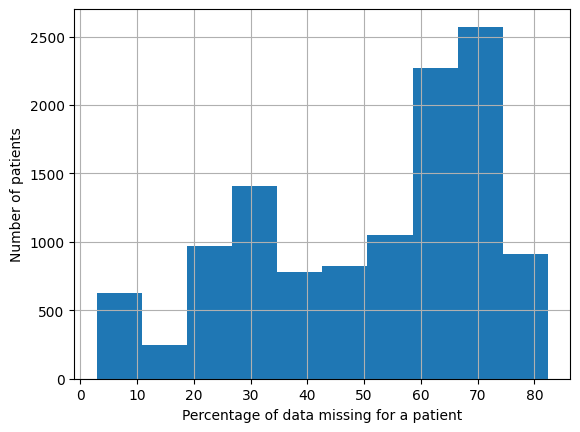

In [ ]:
bin_df = main_df.isna().sum(axis=1)/main_df.shape[1]

bins = (bin_df[bin_df>0]*100).hist(bins=10)
plt.xlabel("Percentage of data missing for a patient")
plt.ylabel("Number of patients")

In [ ]:
bin_df[bin_df > 0].shape

(11649,)

In [ ]:
# Sum of null values in each column
row_to_drop = np.where((main_df.isna().sum(axis=1)/main_df.shape[1] > 0) == True)
main_df.drop(list(row_to_drop[0]), axis=0, inplace=True)

In [ ]:
main_df.shape

(47328, 34)

## Drop any rows with missing hadm_id

ID is our primary key, hence required for any analysis.

In [ ]:
# Storing the null hadm_id in index drop
index_drop = main_df[main_df.hadm_id.isna()].index

In [ ]:
# Dropping the null hadm_id
main_df.drop(index = index_drop, inplace = True)

In [ ]:
# Checking the total number of null values in every column
main_df.isna().sum()

,0
hadm_id,0
age,0
gender,0
marital_status,0
religion,0
ethnicity,0
avg_bicarbonate,0
std_bicarbonate,0
avg_blood_glucose,0
std_blood_glucose,0


##  Categorical features

Performing one hot encoding

In [ ]:
# Making a List of categorical values present in the dataframe
categorical_values = ['gender', 'marital_status', 'religion', 'ethnicity']

In [ ]:
# Making a dataframe for categorical values separately
categorical_df = main_df[categorical_values + ['hadm_id'] ]

In [ ]:
categorical_df

,gender,marital_status,religion,ethnicity,hadm_id
0,F,DIVORCED/SEPARATED,CHRISTIAN,WHITE,100001.0
1,M,SINGLE,NONE,WHITE,100003.0
2,F,SINGLE,NONE,BLACK,100006.0
3,F,MARRIED,JEWISH/HEBREW,WHITE,100007.0
4,M,MARRIED,CHRISTIAN,WHITE,100009.0
...,...,...,...,...,...
58971,M,DIVORCED/SEPARATED,CHRISTIAN,NONE,199993.0
58972,F,SINGLE,CHRISTIAN,WHITE,199994.0
58973,M,SINGLE,CHRISTIAN,WHITE,199995.0
58974,M,MARRIED,CHRISTIAN,WHITE,199998.0


In [ ]:
# Dropping Categorical values
main_df.drop(categorical_values, axis = 1, inplace= True)

In [ ]:
# Checking the number of unique values in every column
categorical_df.nunique()

,0
gender,2
marital_status,5
religion,6
ethnicity,6
hadm_id,47328


In [ ]:
# One hot encoding on the categorical Dataframe
categorical_one_hot = pd.get_dummies(categorical_df, columns= categorical_values)


# from sklearn.preprocessing import LabelEncoder
# encoder = LabelEncoder()
# categorical_one_hot = categorical_df[categorical_values].apply(encoder.fit_transform)
# categorical_one_hot["hadm_id"] = categorical_df["hadm_id"]

In [ ]:
categorical_one_hot

,hadm_id,gender_F,gender_M,marital_status_DIVORCED/SEPARATED,marital_status_MARRIED,marital_status_SINGLE,marital_status_UNKNOWN,marital_status_WIDOWED,religion_BUDDHIST/HINDU,religion_CHRISTIAN,religion_JEWISH/HEBREW,religion_MUSLIM,religion_NONE,religion_ORTHODOX,ethnicity_ASIAN,ethnicity_BLACK,ethnicity_HISPANIC,ethnicity_NONE,ethnicity_OTHER,ethnicity_WHITE
0,100001.0,True,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True
1,100003.0,False,True,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,True
2,100006.0,True,False,False,False,True,False,False,False,False,False,False,True,False,False,True,False,False,False,False
3,100007.0,True,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True
4,100009.0,False,True,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58971,199993.0,False,True,True,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False
58972,199994.0,True,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,True
58973,199995.0,False,True,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,True
58974,199998.0,False,True,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True


## Scaling the numerical features

In [ ]:
# Making a copy of the original dataframe
scaled_df = main_df.copy()

In [ ]:
# # Applying min-max scaling
for col in scaled_df.columns[1:]:
    scaled_df[col] = (scaled_df[col] - scaled_df[col].min())/ (scaled_df[col].max() - scaled_df[col].min())

scaled_df

# from sklearn.preprocessing import StandardScaler
# scaled_df_standard = StandardScaler().fit_transform(scaled_df)
# scaled_df = pd.DataFrame(scaled_df_standard, index=scaled_df.index, columns=scaled_df.columns)

,hadm_id,age,avg_bicarbonate,std_bicarbonate,avg_blood_glucose,std_blood_glucose,avg_blood_urea_nitrogen,std_blood_urea_nitrogen,avg_creatinine,std_creatinine,...,avg_dias_press,std_dias_press,avg_hr,std_hr,avg_resp_rate,std_resp_rate,avg_spo2,std_spo2,avg_sys_press,std_sys_press
0,100001.0,0.267724,0.288265,0.272060,0.189953,0.105529,0.117728,0.112070,0.010618,0.000545,...,0.031715,0.000824,0.000789,0.000012,0.000613,0.000013,0.001122,0.000002,0.045176,0.001045
1,100003.0,0.588045,0.287202,0.256056,0.094095,0.035246,0.143436,0.152249,0.005195,0.000368,...,0.018009,0.000971,0.000497,0.000008,0.000524,0.000014,0.001135,0.000007,0.026499,0.000829
2,100006.0,0.443912,0.504121,0.256511,0.105507,0.044163,0.067886,0.030565,0.003061,0.000192,...,0.027194,0.000991,0.000763,0.000010,0.000687,0.000016,0.001128,0.000006,0.034268,0.000631
3,100007.0,0.770386,0.403770,0.117851,0.124140,0.037811,0.055508,0.030615,0.003197,0.000217,...,0.020800,0.000899,0.000480,0.000011,0.000718,0.000022,0.001130,0.000005,0.034345,0.000598
4,100009.0,0.599638,0.410714,0.123650,0.171516,0.056156,0.067553,0.034418,0.003756,0.000102,...,0.013987,0.000485,0.000379,0.000012,0.000968,0.000032,0.001093,0.000005,0.024563,0.000615
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58971,199993.0,0.596052,0.412408,0.156422,0.130423,0.037217,0.099102,0.090471,0.005093,0.000511,...,0.020273,0.000929,0.000555,0.000011,0.000691,0.000024,0.001100,0.000005,0.023348,0.000713
58972,199994.0,0.566803,0.352307,0.192766,0.116257,0.027486,0.095015,0.066537,0.014505,0.001408,...,0.013931,0.000934,0.000407,0.000007,0.000419,0.000020,0.001109,0.000006,0.023641,0.000797
58973,199995.0,0.112473,0.463068,0.153105,0.116454,0.031275,0.052066,0.028228,0.003185,0.000186,...,0.019098,0.000685,0.000758,0.000007,0.000701,0.000022,0.001117,0.000006,0.025304,0.000533
58974,199998.0,0.709282,0.380208,0.137370,0.140044,0.038805,0.071166,0.038089,0.004475,0.000466,...,0.013912,0.000620,0.000401,0.000007,0.000536,0.000013,0.001143,0.000004,0.029766,0.001118


In [ ]:
# Updating main dataframe by merging min-max scaled df and one hot encoded dataframe
main_df = scaled_df.merge(categorical_one_hot, on = 'hadm_id', how = 'outer')

In [ ]:
# Feature column list to train the model in kmeans
feature_columns = main_df.columns.to_list()
feature_columns.remove("hadm_id")

# Data visualization

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(learning_rate=50)
tsne_features = tsne.fit_transform(main_df[feature_columns])

Text(0.5, 1.0, 'Visualizing data with TSNE')

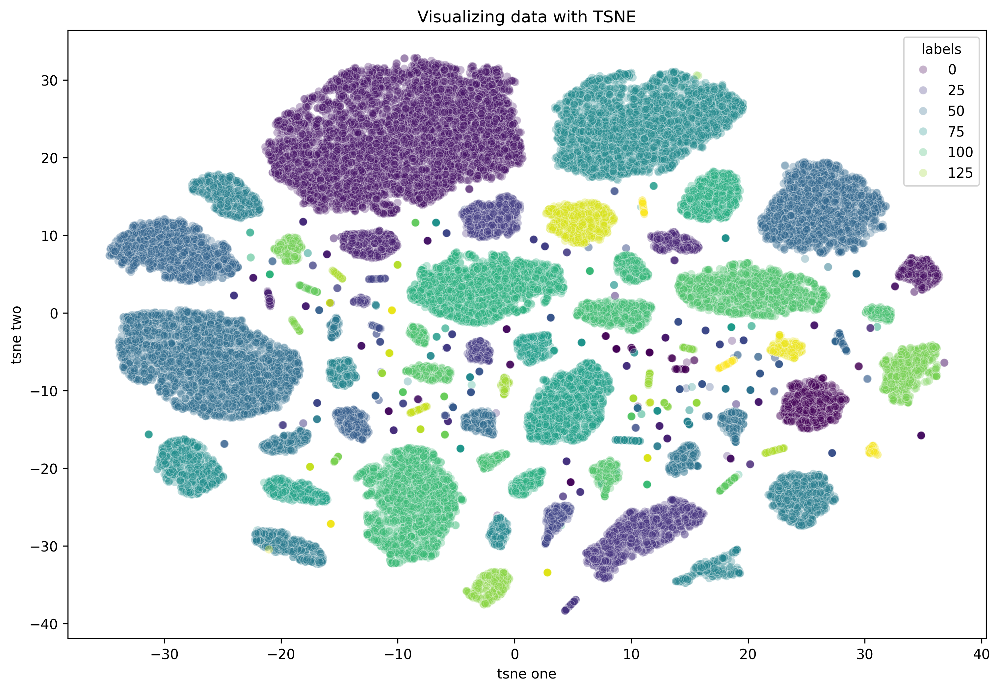

In [ ]:
import seaborn as sns

df_tsne = pd.DataFrame()
df_tsne['tsne one'] = tsne_features[:,0]
df_tsne['tsne two'] = tsne_features[:,1]
df_tsne["labels"] = label2

plt.figure(figsize=(12,8), dpi=300)

sns.scatterplot(
    x="tsne one", y="tsne two",
    hue="labels",
    data=df_tsne,
    alpha=0.3,
    palette='viridis'
)

plt.title("Visualizing data with TSNE")
# plt.savefig("TSNE_no_impute_one_hot.jpeg")

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
pca_features = pca.fit_transform(main_df[feature_columns])

df_pca = pd.DataFrame()
df_pca['pca one'] = pca_features[:,0]
df_pca['pca two'] = pca_features[:,1]
df_pca['pca three'] = pca_features[:,2]
df_pca['labels'] = label

Text(0.5, 1.0, 'Visualizing data with PCA - 2D')

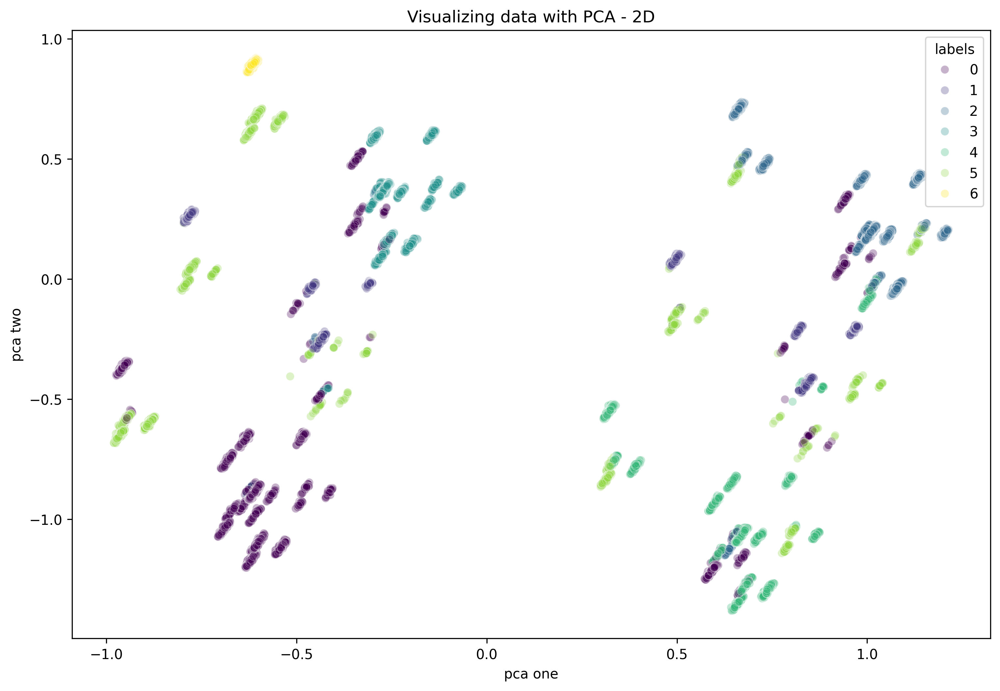

In [ ]:
plt.figure(figsize=(12,8), dpi=300)

sns.scatterplot(
    x="pca one", y="pca two",
    data=df_pca,
    hue="labels",
    alpha=0.3,
    palette='viridis'
)

plt.title("Visualizing data with PCA - 2D")
# plt.savefig("PCA_no_impute_one_hot.jpeg")

Text(0.5, 0.92, 'Visualizing data with PCA - 3D')

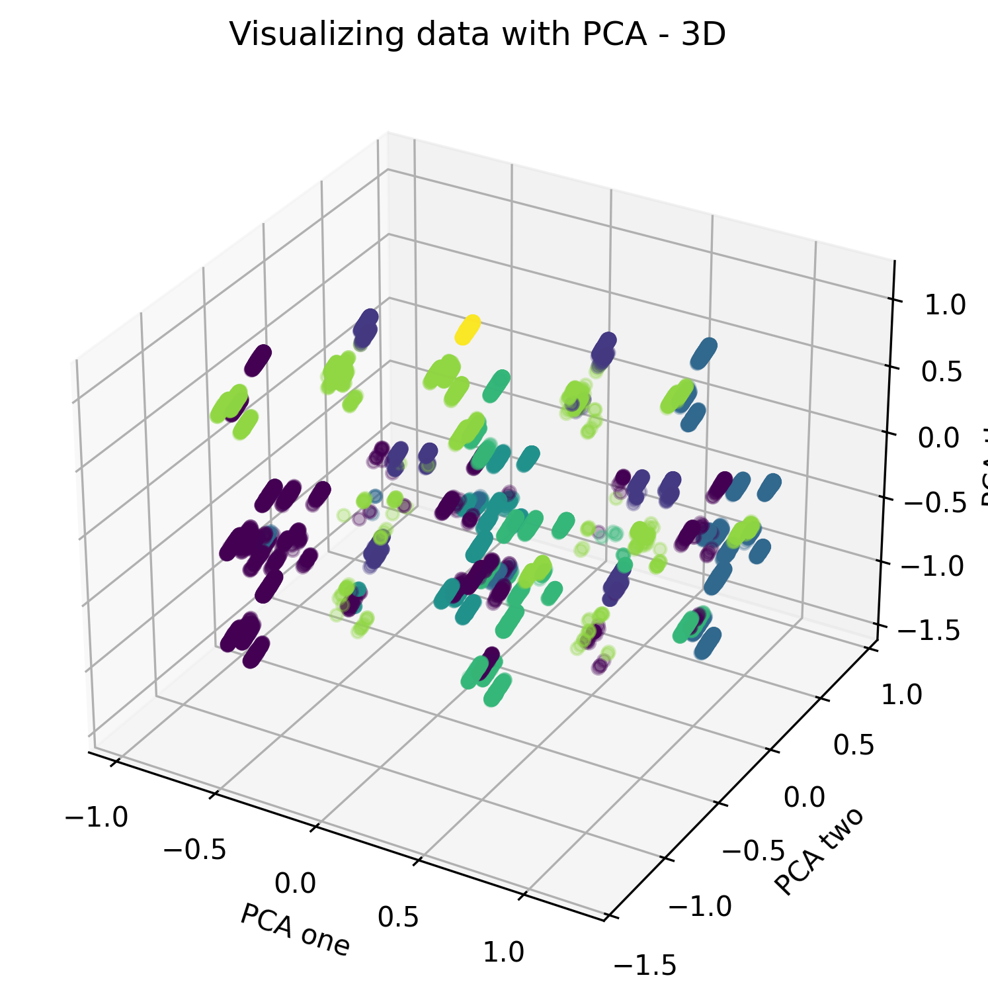

In [ ]:
fig = plt.figure(figsize=(8, 6), dpi=300)
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(df_pca["pca one"], df_pca["pca two"], df_pca["pca three"], c =df_pca['labels'], alpha=0.3)
ax.set_xlabel("PCA one")
ax.set_ylabel("PCA two")
ax.set_zlabel("PCA three")
plt.title("Visualizing data with PCA - 3D")
# plt.savefig("PCA3D_no_impute_one_hot.jpeg")

# Hierarchical Clustering - Agglomerative

In [ ]:
# Hierarchical Clustering
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
import matplotlib.pyplot as plt

ward


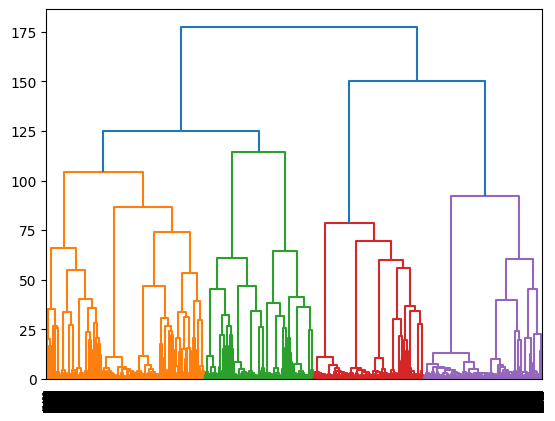

complete


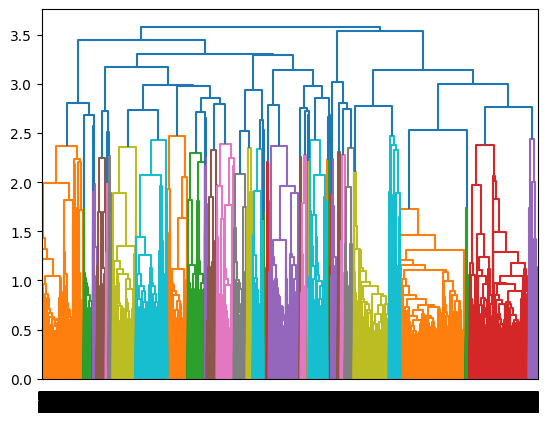

average


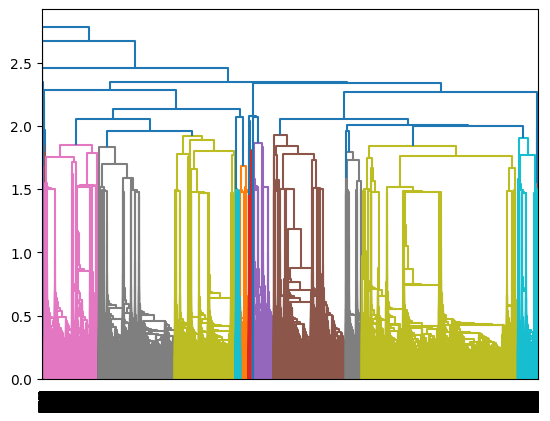

In [ ]:
cluster_list = {'ward': [], 'complete' : [], 'average': []}
method_list = ['ward', 'complete', 'average']

for method in method_list:
    print(method)

    ac = AgglomerativeClustering(linkage = method, distance_threshold=0, n_clusters=None)
    ac = ac.fit(main_df[feature_columns])

    link = linkage(main_df[feature_columns], method = method)
    plt.figure()
    dend = dendrogram(link, no_plot= False)
    plt.savefig(f"{method}_no_impute_one_hot.jpg")
    plt.show()
    clusters = len(set(dend['color_list'])) - 1
    cluster_list[method].append((ac, link, dend))

## Helper functions

Cut_dendogram for finding where the horizontal line cuts the tree and finding clusters.

In [ ]:
def cut_dendogram(dendro, h_line):

    # Extract icoord and dcoord
    icoord_list = dendro['icoord']  # X-coordinates of the clusters
    dcoord_list = dendro['dcoord']  # Y-coordinates (heights at which merges happen)

    # Count intersecting lines
    intersect_count = 0

    for i in range(len(icoord_list)):
        y1, y2, y3, y4 = dcoord_list[i]
        # print(y1, y2)

        if min(y1, y2) <= h_line <= max(y1, y2):
            intersect_count += 1
        if min(y3, y4) <= h_line <= max(y3, y4):
            intersect_count += 1

    return intersect_count

### Manually finding vertical gain

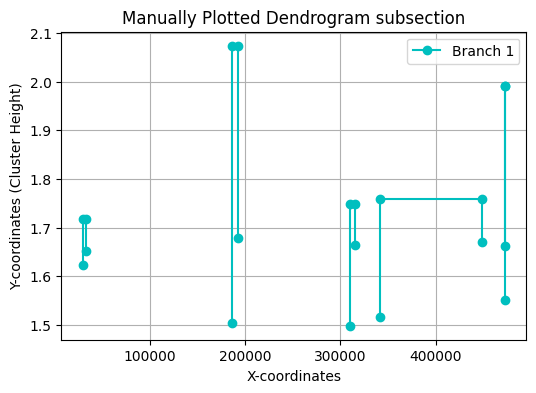

In [ ]:
import matplotlib.pyplot as plt

# Example icoord and dcoord
icoord = [cluster_list["average"][0][2]["icoord"][i] for i in test]
dcoord = [cluster_list["average"][0][2]["dcoord"][i] for i in test]

# Create a plot
fig, ax = plt.subplots(figsize=(6, 4))

# Plot each branch segment
for i in range(len(icoord)):
    x_vals = icoord[i]
    y_vals = dcoord[i]
    ax.plot(x_vals, y_vals, marker='o', linestyle='-', color='c', label=f'Branch {i+1}' if i == 0 else "")

# Add labels
ax.set_title("Manually Plotted Dendrogram subsection")
ax.set_xlabel("X-coordinates")
ax.set_ylabel("Y-coordinates (Cluster Height)")
ax.legend()
ax.grid(True)

# Show plot
plt.show()


In [ ]:
test = [idx for idx, i in enumerate(cluster_list["average"][0][2]["dcoord"]) if (i[-1] > 1.6 and i[-1] < 1.7) ]

In [ ]:
print(cut_dendogram(cluster_list["ward"][0][2], h_line=92.41))
print(cut_dendogram(cluster_list["complete"][0][2], h_line=1.737))
print(cut_dendogram(cluster_list["average"][0][2], h_line=1.679))

7
146
59


In [ ]:
ward_clusters = 7
complete_clusters = 146
average_clusters = 59

# Training optimal models

In [ ]:
ac = AgglomerativeClustering(linkage = "ward", n_clusters=ward_clusters)
label = ac.fit_predict(main_df[feature_columns])

In [ ]:
ac2 = AgglomerativeClustering(linkage = "complete", n_clusters=complete_clusters)
label2 = ac2.fit_predict(main_df[feature_columns])

In [ ]:
ac3 = AgglomerativeClustering(linkage = "average", n_clusters=average_clusters)
label3 = ac3.fit_predict(main_df[feature_columns])

In [ ]:
from sklearn.metrics import silhouette_score, calinski_harabasz_score

sil_score = silhouette_score(main_df[feature_columns],label)
print(sil_score)

ch_score = calinski_harabasz_score(main_df[feature_columns], label)
print(ch_score)

0.22131081299279343
6738.473095048175


In [ ]:
sil_score = silhouette_score(main_df[feature_columns],label2)
print(sil_score)

ch_score = calinski_harabasz_score(main_df[feature_columns], label2)
print(ch_score)

0.6855086711436417
5442.100627732115


In [ ]:
sil_score = silhouette_score(main_df[feature_columns],label3)
print(sil_score)

ch_score = calinski_harabasz_score(main_df[feature_columns], label3)
print(ch_score)

0.3619611322575208
2066.9354503433724


In [ ]:
main_df["label_ward"] = label
main_df["label_complete"] = label2
main_df["label_average"] = label3

# Analysis

In [ ]:
for col in feature_columns:
    plt.figure(figsize=(18, 6), dpi=300)
    sns.violinplot(x=main_df["label_ward"], y=main_df[col])
    plt.title(f"Distribution of {col} in each cluster")
    plt.savefig(f"algo/plots/ward/{col.replace("/", "_")}.jpeg")
    plt.close()

In [ ]:
for col in feature_columns:
    plt.figure(figsize=(18, 6), dpi=300)
    sns.violinplot(x=main_df["label_complete"], y=main_df[col])
    plt.title(f"Distribution of {col} in each cluster")
    plt.savefig(f"algo/plots/complete/{col.replace("/", "_")}.jpeg")
    plt.close()

In [ ]:
for col in feature_columns:
    plt.figure(figsize=(18, 6), dpi=300)
    sns.violinplot(x=main_df["label_average"], y=main_df[col])
    plt.title(f"Distribution of {col} in each cluster")
    plt.savefig(f"algo/plots/average/{col.replace("/", "_")}.jpeg")
    plt.close()

## TSNE and PCA visualization

In [ ]:
algo_combos = [("ward", ward_clusters, label), ("complete", complete_clusters, label2), ("average", average_clusters, label3)]

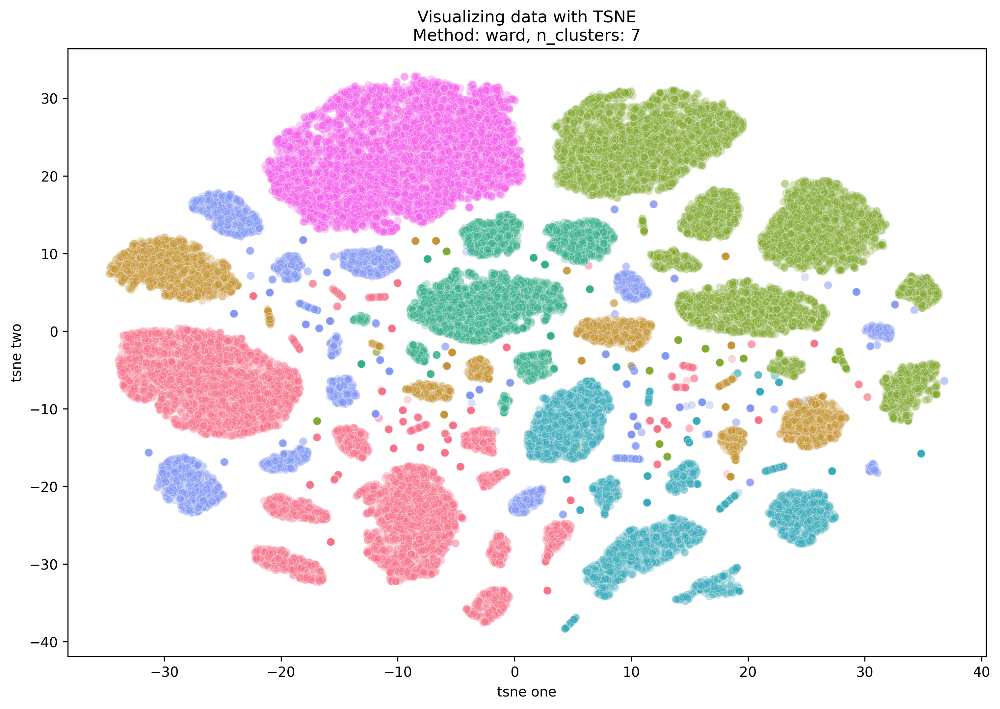

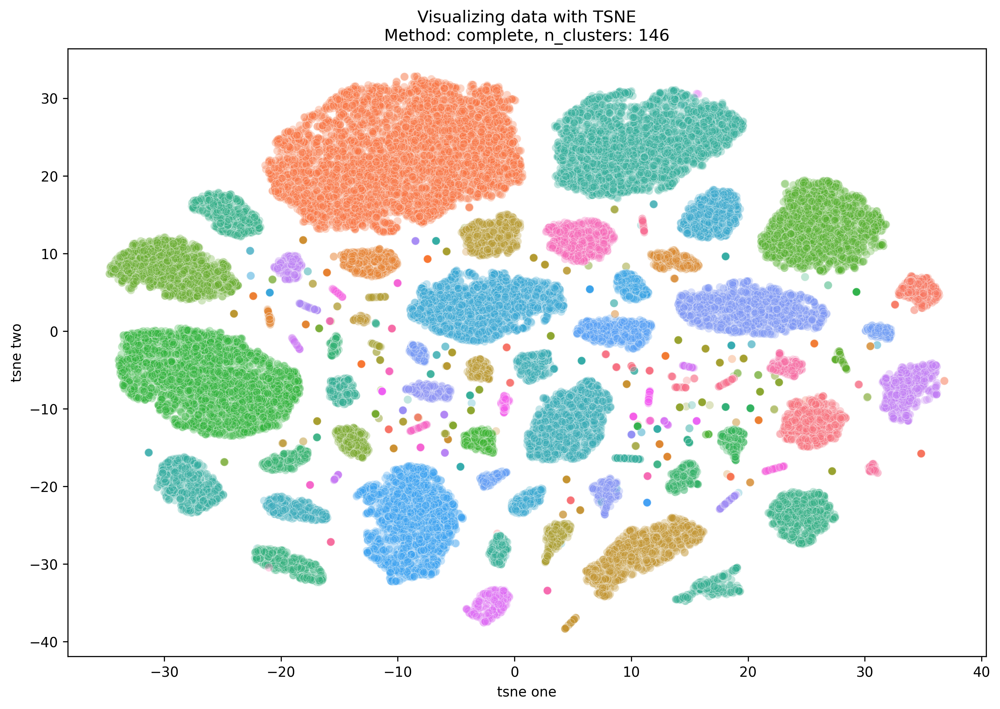

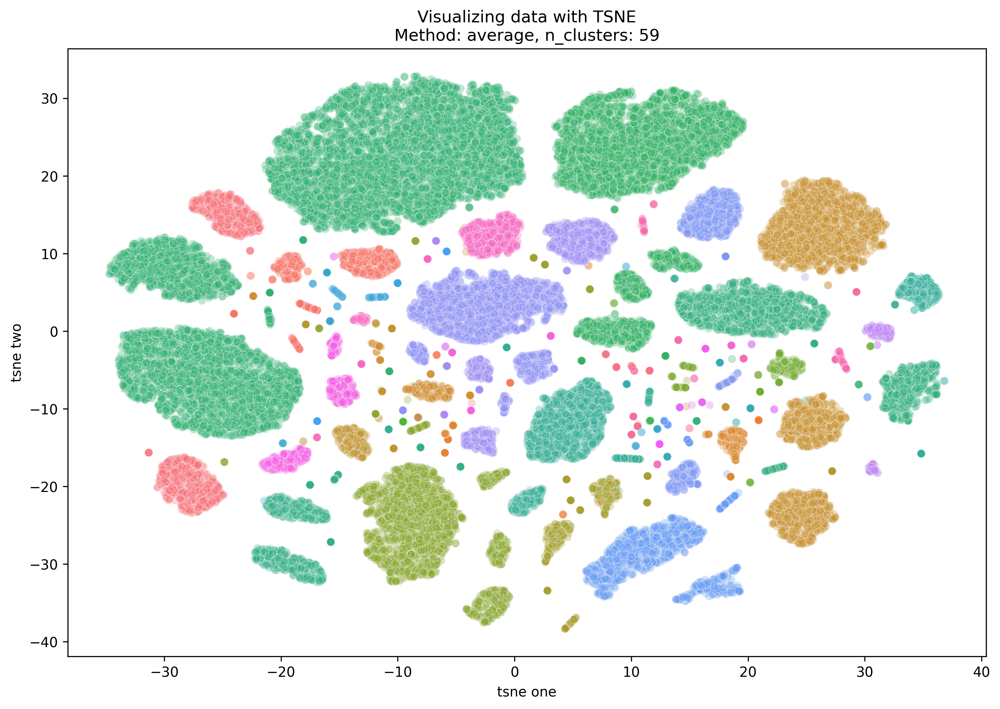

In [ ]:
import seaborn as sns

for method, clusters_count, output_label in algo_combos:
    df_tsne = pd.DataFrame()
    df_tsne['tsne one'] = tsne_features[:,0]
    df_tsne['tsne two'] = tsne_features[:,1]
    df_tsne["labels"] = output_label

    plt.figure(figsize=(12,8), dpi=300)

    sns.scatterplot(
        x="tsne one", y="tsne two",
        hue="labels",
        data=df_tsne,
        alpha=0.3,
        palette= sns.color_palette("husl", n_colors=df_tsne.labels.nunique()),
        legend=False
    )

    plt.title(f"Visualizing data with TSNE\nMethod: {method}, n_clusters: {clusters_count}")
    plt.savefig(f"TSNE_no_impute_one_hot_{method}_{clusters_count}.jpeg")

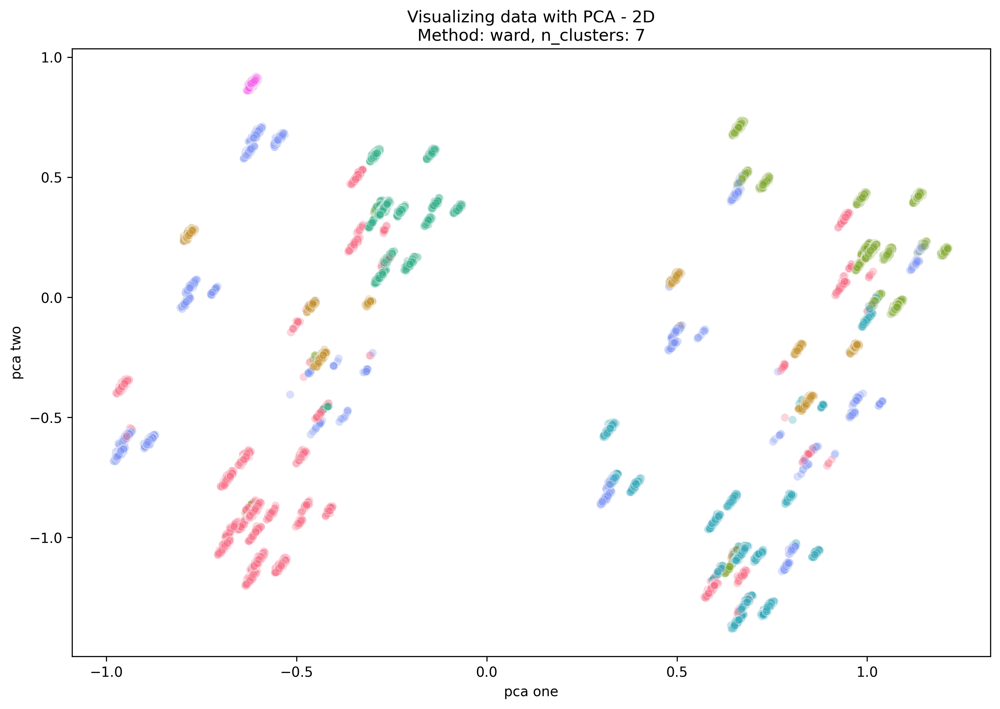

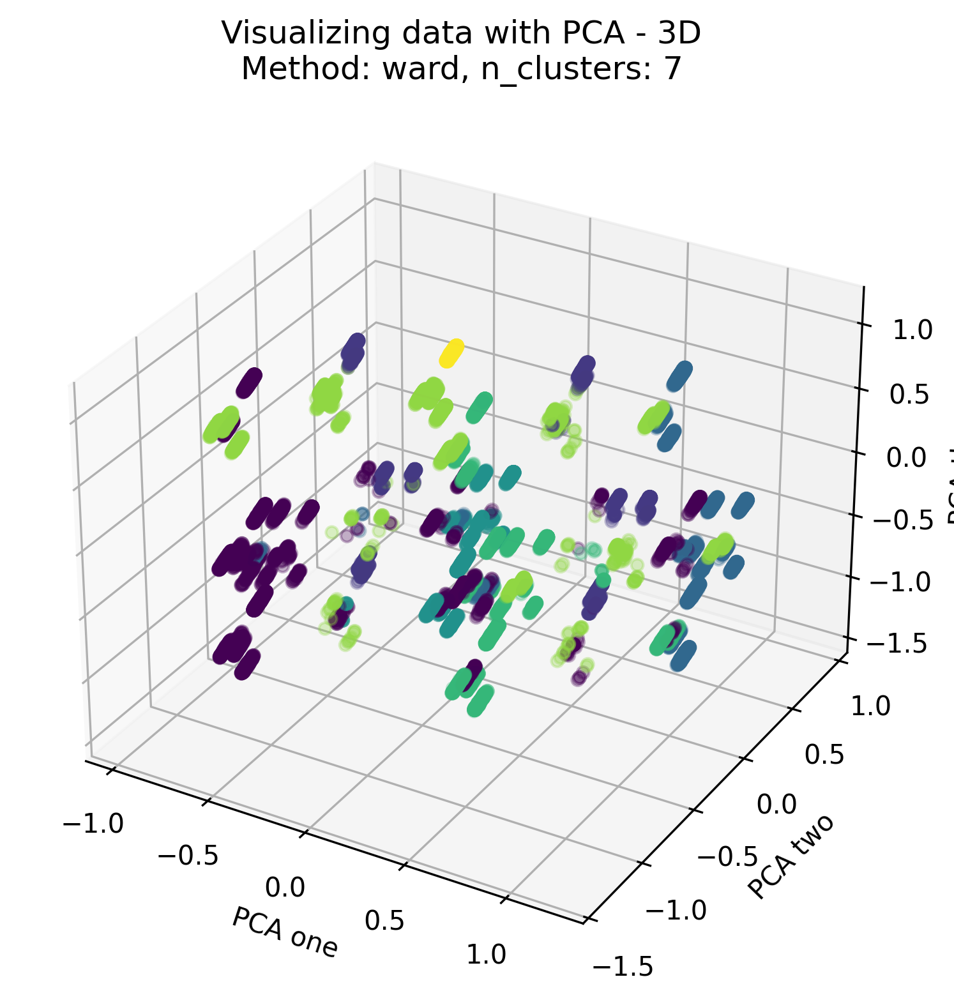

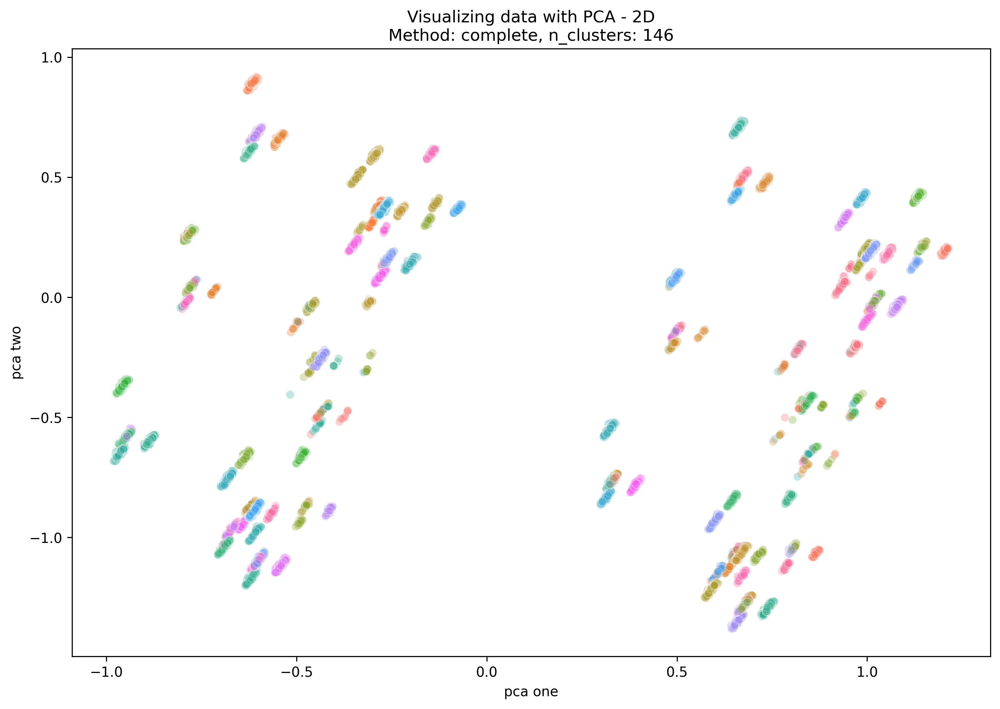

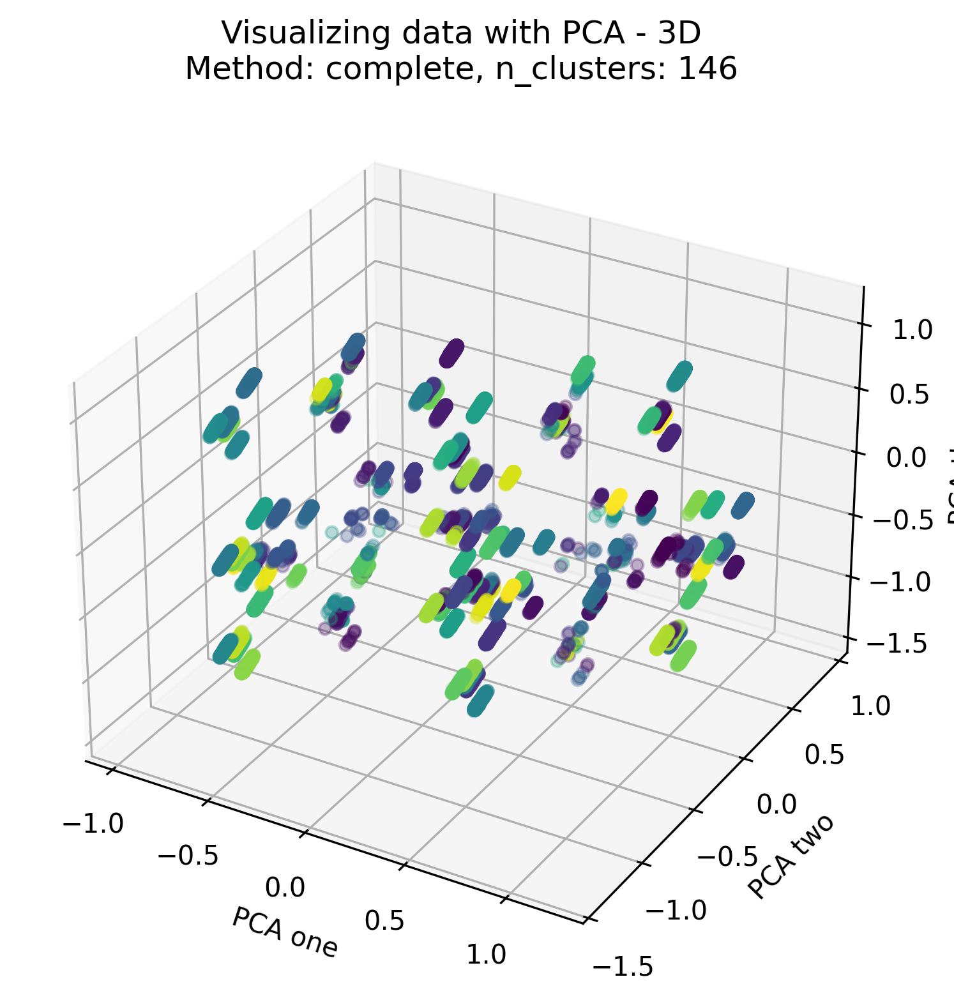

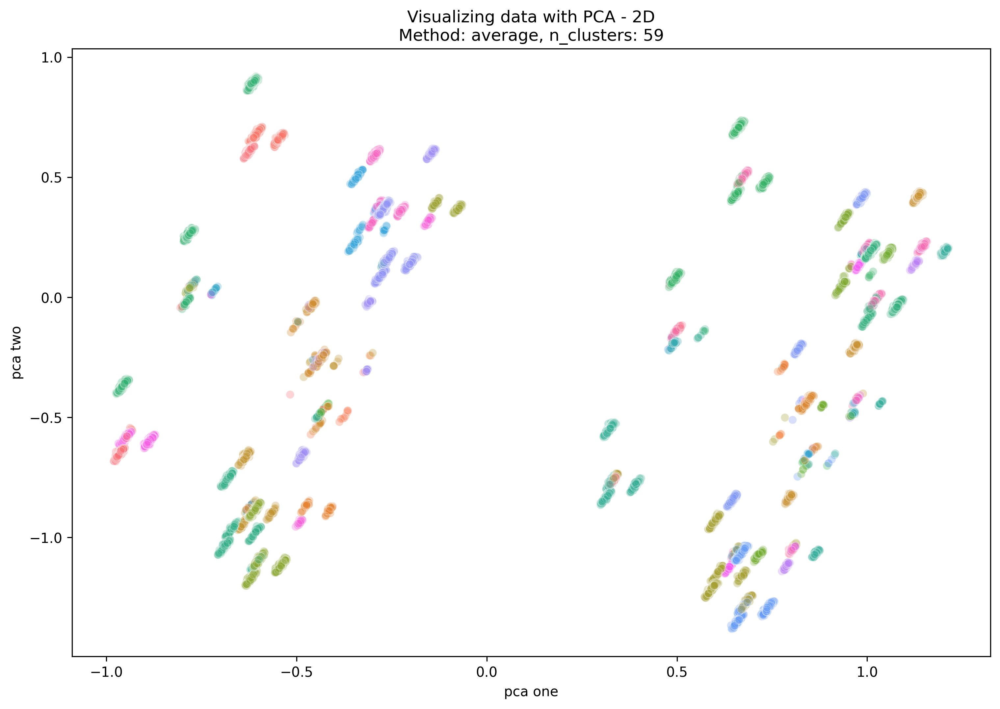

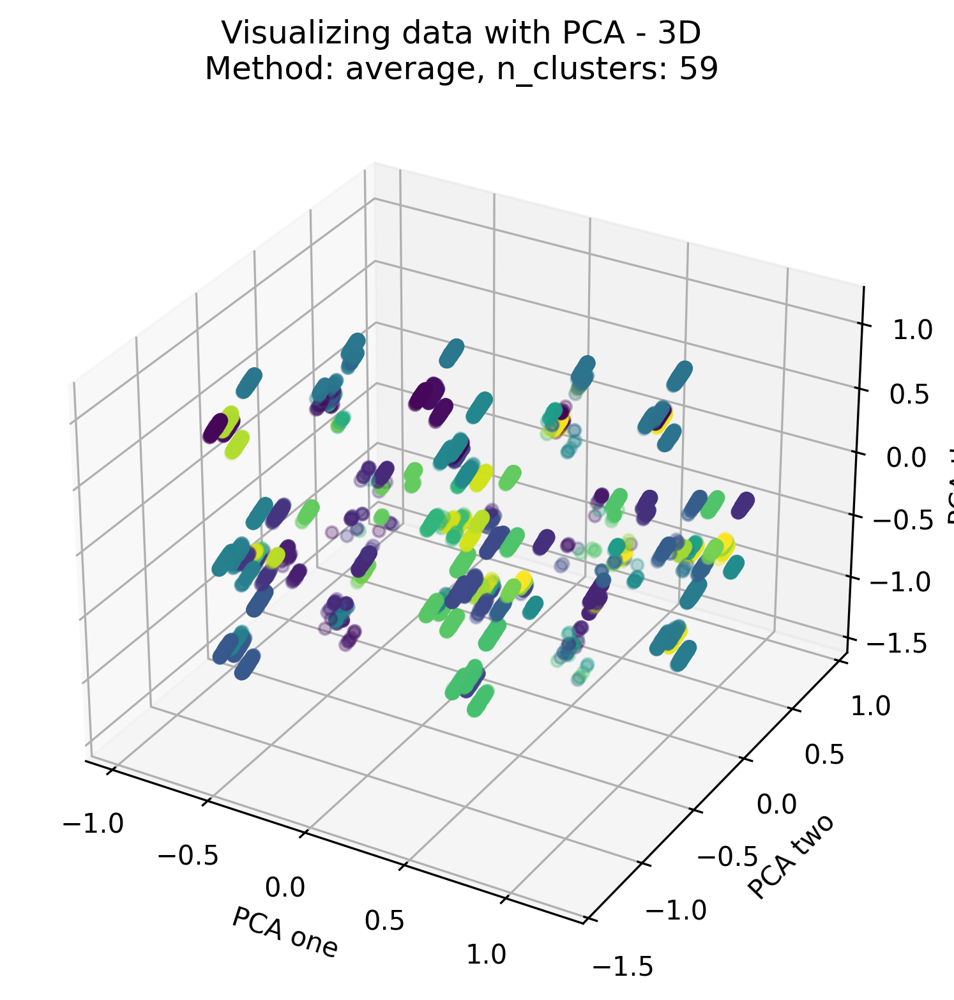

In [ ]:
for method, clusters_count, output_label in algo_combos:

    df_pca = pd.DataFrame()
    df_pca['pca one'] = pca_features[:,0]
    df_pca['pca two'] = pca_features[:,1]
    df_pca['pca three'] = pca_features[:,2]
    df_pca['labels'] = output_label

    plt.figure(figsize=(12,8), dpi=300)

    sns.scatterplot(
        x="pca one", y="pca two",
        data=df_pca,
        hue="labels",
        alpha=0.3,
        palette= sns.color_palette("husl", n_colors=df_pca.labels.nunique()),
        legend=False
    )

    plt.title(f"Visualizing data with PCA - 2D\nMethod: {method}, n_clusters: {clusters_count}")
    plt.savefig(f"PCA_no_impute_one_hot_{method}_{clusters_count}.jpeg")

    fig = plt.figure(figsize=(8, 6), dpi=300)
    ax = fig.add_subplot(111, projection='3d')
    sc = ax.scatter(df_pca["pca one"], df_pca["pca two"], df_pca["pca three"], c =df_pca['labels'], alpha=0.3)
    ax.set_xlabel("PCA one")
    ax.set_ylabel("PCA two")
    ax.set_zlabel("PCA three")
    plt.title(f"Visualizing data with PCA - 3D\nMethod: {method}, n_clusters: {clusters_count}")
    plt.savefig(f"PCA3D_no_impute_one_hot_{method}_{clusters_count}.jpeg")